In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scanpy as sc
import anndata as ad
import scipy.sparse as sp
from matplotlib import rcParams
import glob
import gc
import sys
sys.path.append("/Users/irene.bonafonte/Documents/PhD/Software/nichecompass/")
from nichecompass.models import NicheCompass
from matplotlib.colors import ListedColormap, to_rgb, to_hex

In [2]:
dataset = 'nanostring_cosmx_human_nsclc'
model = 'reference_query_mapping'

# Load

['#1f77b4', '#ff7f0e']

In [3]:
def load_model(suffix):
    model_folder = glob.glob(f'../../../artifacts/{dataset}/models/*_{suffix}')[0]
    adata = sc.read_h5ad(f"{model_folder}/{dataset}_{model}.h5ad")
    adata.obs_names = adata.obs['cell_ID'].values
    adata.obs['cell type'] = adata.obs['cell_type_original'].map({
        'tumor 9': 'tumor', 'tumor 6': 'tumor', 'tumor 5': 'tumor', 'tumor 13': 'tumor', 'tumor 12': 'tumor',
        'fibroblast': 'fibroblast', 'neutrophil': 'neutrophil', 'plasmablast': 'plasmablast', 'B-cell': 'B-cell', 'endothelial': 'endothelial', 'epithelial': 'epithelial',
        'T CD4 naive': 'T cell/NK', 'T CD4 memory': 'T cell/NK', 'T CD8 naive': 'T cell/NK', 'T CD8 memory': 'T cell/NK', 'Treg': 'T cell/NK', 'NK': 'T cell/NK',
        'mDC': 'DC/monocyte', 'pDC': 'DC/monocyte', 'monocyte': 'DC/monocyte', 'macrophage': 'macrophage', 'mast': 'mast'
    }).astype("category")
    adata.uns['cell type_colors'] = np.apply_along_axis(to_hex, 1, np.array(plt.get_cmap('tab20').colors))[[6,10,2,14,4,5,0,1,8,12,18]]
    adata.uns['cell type_colors'][3] = '#ffff33'
    adata.uns['mapping_entity_colors'] = ['#00AFBB', '#999999']
    adata.obs['cell type'] = adata.obs['cell type'].cat.reorder_categories(['tumor','fibroblast','endothelial','epithelial','macrophage','DC/monocyte','B-cell','plasmablast', 'T cell/NK', 'mast', 'neutrophil'], ordered=False)
    sc.pl.umap(adata, color=['batch','cell type','niche','mapping_entity'], ncols=4, wspace=0.5, size=0.5)
    sc.pl.umap(adata[adata.obs.mapping_entity == 'reference'], color=['batch','cell type','niche'], ncols=4, wspace=0.5, size=0.5)
    new_batches = adata.obs.loc[adata.obs.mapping_entity == 'query','batch'].unique()
    sc.pl.umap(adata[adata.obs.batch != new_batches[1]], color=['mapping_entity','cell type','niche'], ncols=4, wspace=0.5, size=0.5)
    sc.pl.umap(adata[adata.obs.batch != new_batches[0]], color=['mapping_entity','cell type','niche'], ncols=4, wspace=0.5, size=0.5)

    
    adata = NicheCompass.load(dir_path=model_folder,
                          adata=adata,
                          gp_names_key='nichecompass_gp_names')
    
    gc.collect()
    return adata

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/pyth

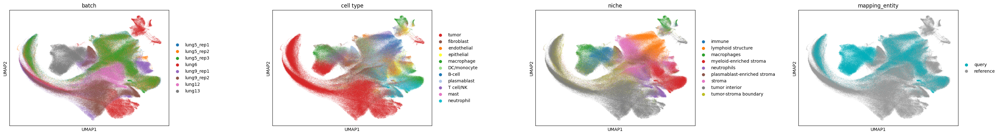

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


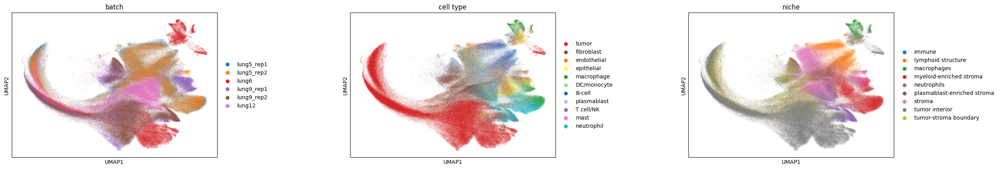

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


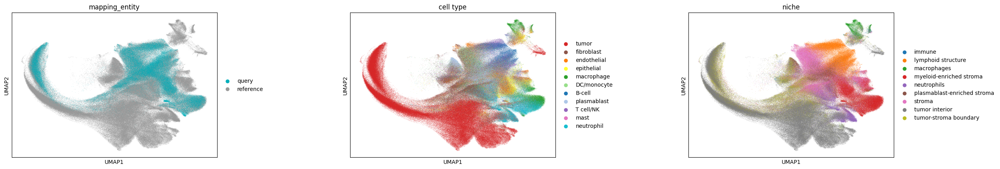

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


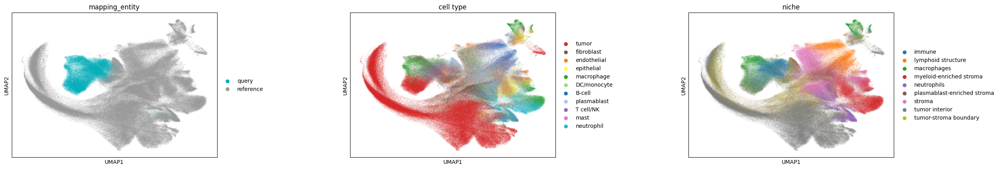

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1494, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [4]:
# 13 (grey), 5 (green)
madata = load_model('101')

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/pyth

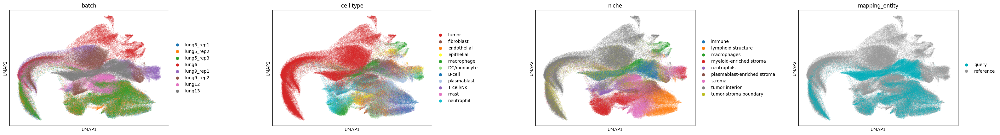

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


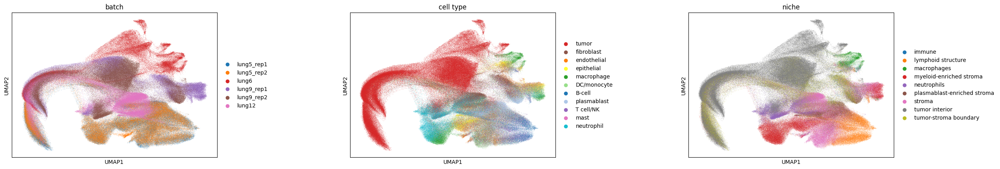

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


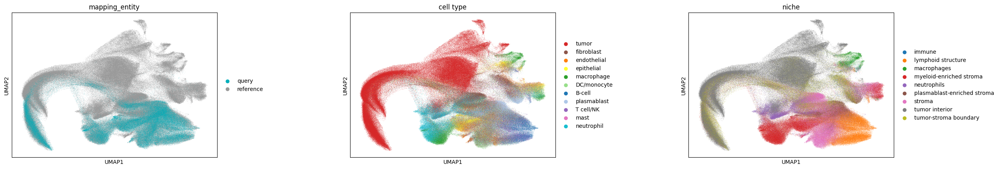

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


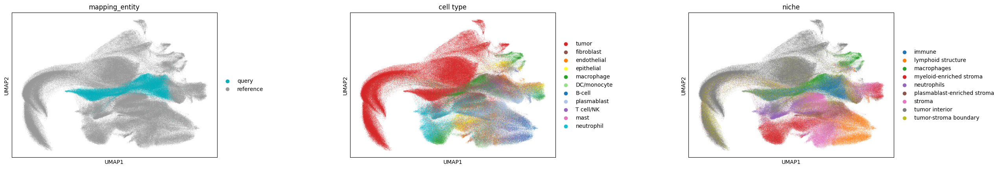

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1494, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [5]:
# 13 (grey), 5 (green)
madata = load_model('102')

In [ ]:
madata.__dict__

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/pyth

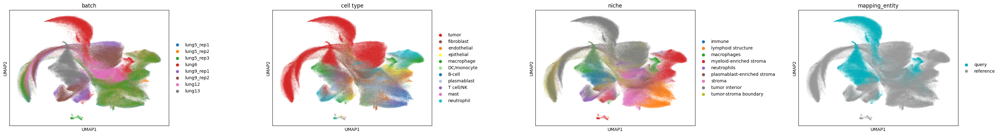

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


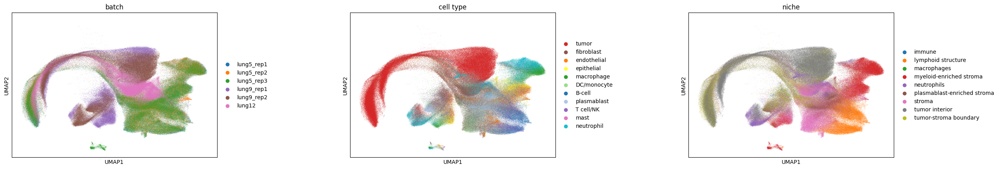

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


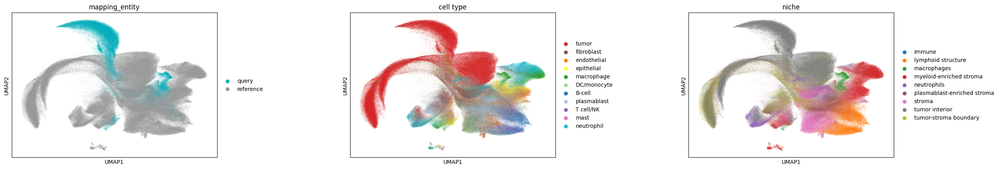

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


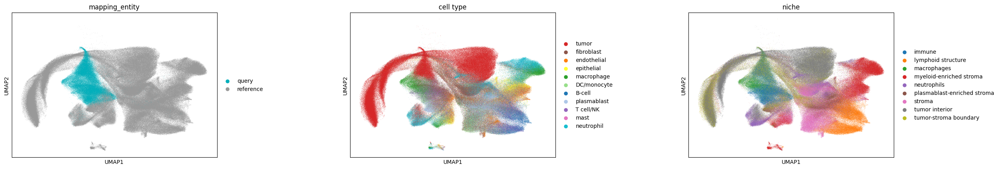

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1494, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [72]:
# 6 red, 13 grey
madata = load_model('103')

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/pyth

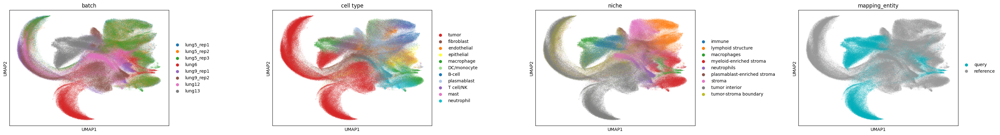

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


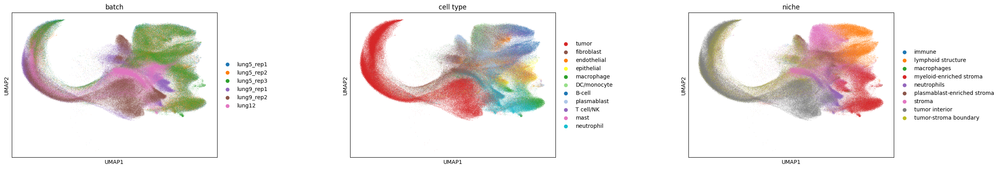

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


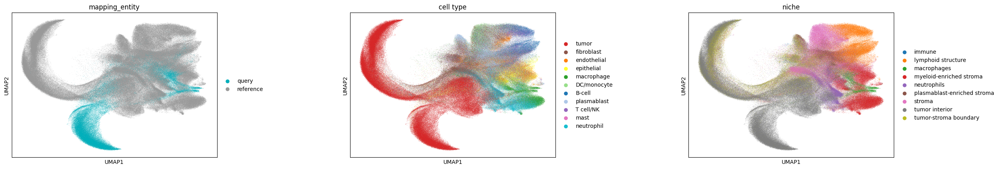

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


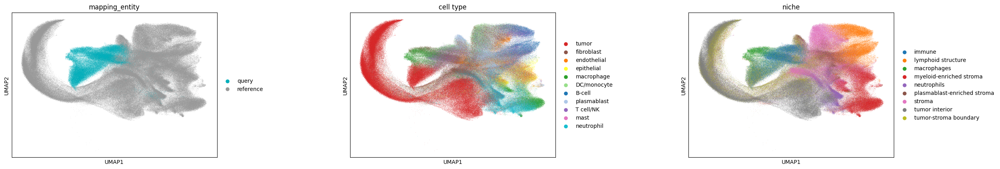

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1494, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [73]:
# 6 red, 13 grey
madata = load_model('104')

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/pyth

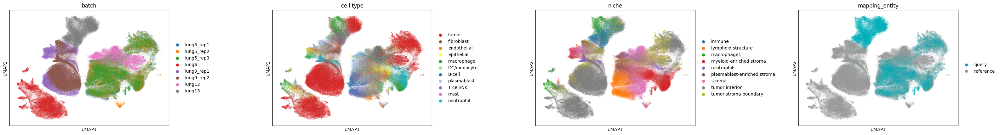

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


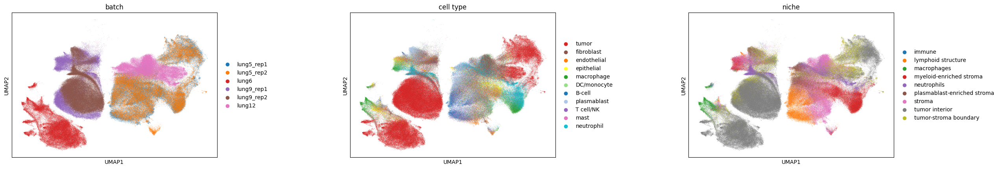

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


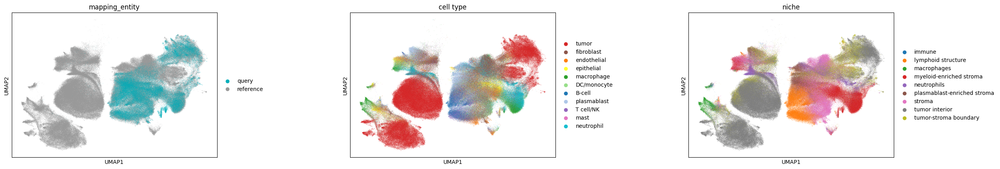

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


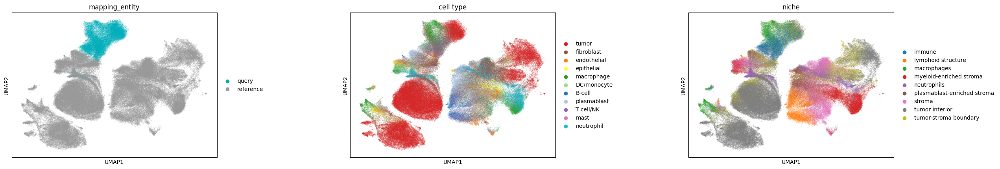

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1494, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [74]:
# 5 green, 13 grey
madata = load_model('105')